# Exercise 3 - HDR reconstruction and camera chracterization

In [1]:
# Group Number: 03
# Group Members: Kurt Kilian Eifler, Moritz Ladwig, Simon Grünewald

# Imports
import numpy as np
import numpy.matlib
import numpy.random
from matplotlib import pyplot as plt
import matplotlib
from scipy import ndimage
from scipy import misc
from scipy import fftpack
from scipy import optimize
import scipy.io
import skimage
import imageio

from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

# for 16 bit PNG support in imageio if needed, imageio.plugins.freeimage.download() might need to be run once per system (or exr/hdr/pgm/ppm support)

%matplotlib inline
matplotlib.rcParams['figure.figsize'] = (25.0, 25.0)

In [2]:
# Some useful functions
def applyColorMatrix(values, mat):
    tmp = values.reshape(-1, 3)
    tmp = np.matmul(tmp, mat)
    return np.reshape(tmp, values.shape)

def srgb2linear(x):
    linear = x.copy()
    less = linear <= 0.0404482362771082
    linear[less] = linear[less] / 12.92
    linear[~less] = np.power((linear[~less] + 0.055) / 1.055, 2.4)
    return linear

    
def linear2srgb(x):
    srgb = x.copy()
    less = x <= 0.0031308
    srgb[less] = x[less] * 12.92
    srgb[~less] = 1.055 * np.power(x[~less], 1.0 / 2.4) - 0.055
    return srgb

# 3.1 HDR reconstruction - entfernt, Ergebnis als just stack gespeichert


# 3.2 Camera characterization
Looking at the image from exercise 3.1 it can be seen that the colors are not displayed faithfully. We will use three different methods that we learned in the lecture to adjust the colors from the native color space of the 5DMkII to sRGB.

In [3]:
hdrImg = np.load('hdr_image_just_stack.npy')

In [4]:
# These are ther reference Color Checker Values from Babelcolor
cc_ref = np.array([[115, 82, 68], [195, 149, 128], [93, 123, 157], [91, 108, 65], [130, 129, 175], [99, 191, 171], [220, 123, 46], [72, 92, 168], [194, 84, 97], [91, 59, 104], [161, 189, 62], [229, 161, 40], [42, 63, 147], [72, 149, 72], [175, 50, 57], [238, 200, 22], [188, 84, 150], [0, 137, 166], [245, 245, 240], [201, 202, 201], [161, 162, 162], [120, 121, 121], [83, 85, 85], [50, 50, 51]], dtype=np.float)

# Convert these reference values from 8 bit sRGB to scene linear
cc_ref = srgb2linear(cc_ref / 255.0)  #R cc_ref = # our code here
print(cc_ref) # Look Up für 18% Grau

[[0.1714411  0.08437621 0.05780543]
 [0.54572446 0.30054379 0.2158605 ]
 [0.10946171 0.19806932 0.33716362]
 [0.10461648 0.14995979 0.05286065]
 [0.22322796 0.2195262  0.4286905 ]
 [0.12477182 0.52099557 0.40724021]
 [0.7156935  0.19806932 0.02732089]
 [0.06480327 0.1070231  0.39157248]
 [0.53947949 0.08865559 0.11953843]
 [0.10461648 0.04373503 0.13843162]
 [0.35640014 0.50888132 0.04817182]
 [0.78353779 0.35640014 0.02121901]
 [0.02315337 0.04970657 0.29177065]
 [0.06480327 0.30054379 0.06480327]
 [0.4286905  0.03189603 0.0409152 ]
 [0.85499261 0.57758044 0.00802319]
 [0.50288646 0.08865559 0.30498731]
 [0.         0.25015828 0.38132601]
 [0.91309865 0.91309865 0.87136712]
 [0.58407842 0.59061884 0.58407842]
 [0.35640014 0.36130678 0.36130678]
 [0.18782077 0.19120168 0.19120168]
 [0.08650046 0.09084171 0.09084171]
 [0.03189603 0.03189603 0.03310477]]


In [5]:
# Position values/vsize/hsize multiplied by two to reflect position difference from MATLAB (half debayer) to bilinear debayer

def getCheckerValuesFromHausImage(img, no_checker=False):
    """
    Helper function to extract the color checker patches median values for all 24 color patches of the MacBeth chart
    """
    crop_values = np.concatenate(( np.ones((1,6)) * 2053,
                                   np.ones((1,6)) * 2090,
                                   np.ones((1,6)) * 2127,
                                   np.ones((1,6)) * 2163), axis=1) 
    crop_values = np.concatenate(( crop_values,
                                   np.array([1046, 1081, 1117, 1154, 1190, 1227,   1046, 1081, 1118, 1155, 1191, 1228, 1046, 1081, 1118, 1155, 1191, 1228,   1046, 1081, 1118, 1155, 1191, 1228])[:,None].T  - 1.5), axis=0) - 5
    crop_values = np.uint32(crop_values)

    vsize = 26
    hsize = 26 

    cc_values = np.zeros((24, 3))

    select = np.zeros((img.shape[0], img.shape[1]), dtype=int)

    for i in range(24):
        # using nanmedian in case we somehow have an invalid pixel value (nanmedian ignores nan-values)
        tmp = np.nanmedian(img[crop_values[0, i]:crop_values[0, i]+hsize, crop_values[1, i]:crop_values[1, i]+vsize, :], axis=0)
        cc_values[i, :] = np.nanmedian(tmp, axis=0)
        select[crop_values[0, i]:crop_values[0, i]+hsize, crop_values[1, i]:crop_values[1, i]+vsize] = 1

    if not no_checker:
        errosion_structure = ndimage.generate_binary_structure(2, 1)
        select = select - ndimage.grey_erosion(select, size=(3,3), footprint=errosion_structure)
        
        tmp_img = img / np.max(img) + select[:,:,None]
        tmp_img = tmp_img[2030:2210, 1010:1290,:]
        plt.imshow(linear2srgb(tmp_img / np.max(tmp_img)))
        plt.show()

    return cc_values

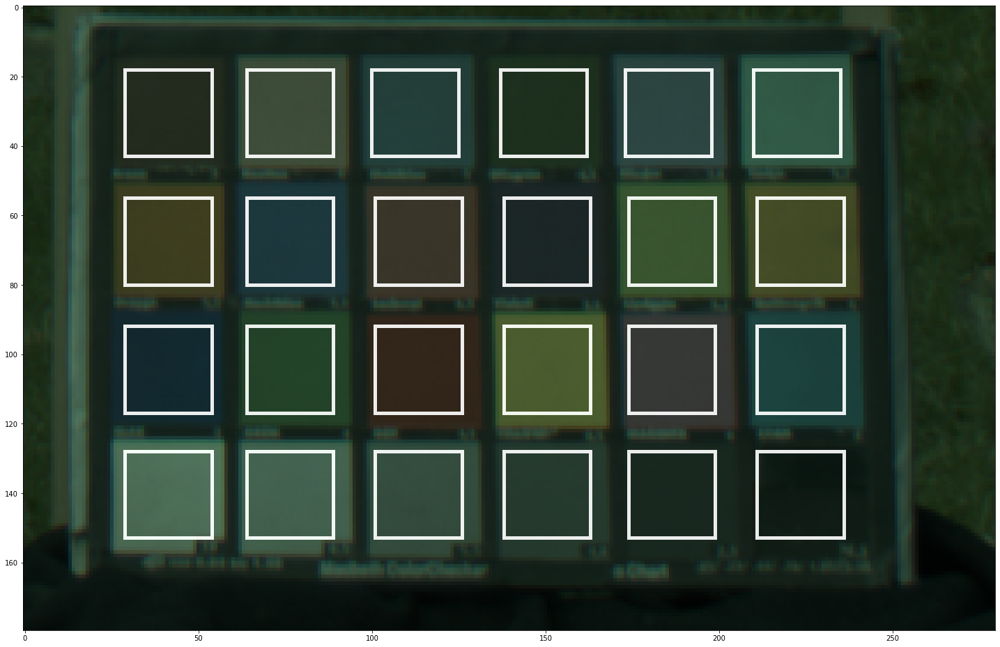

(24, 3)

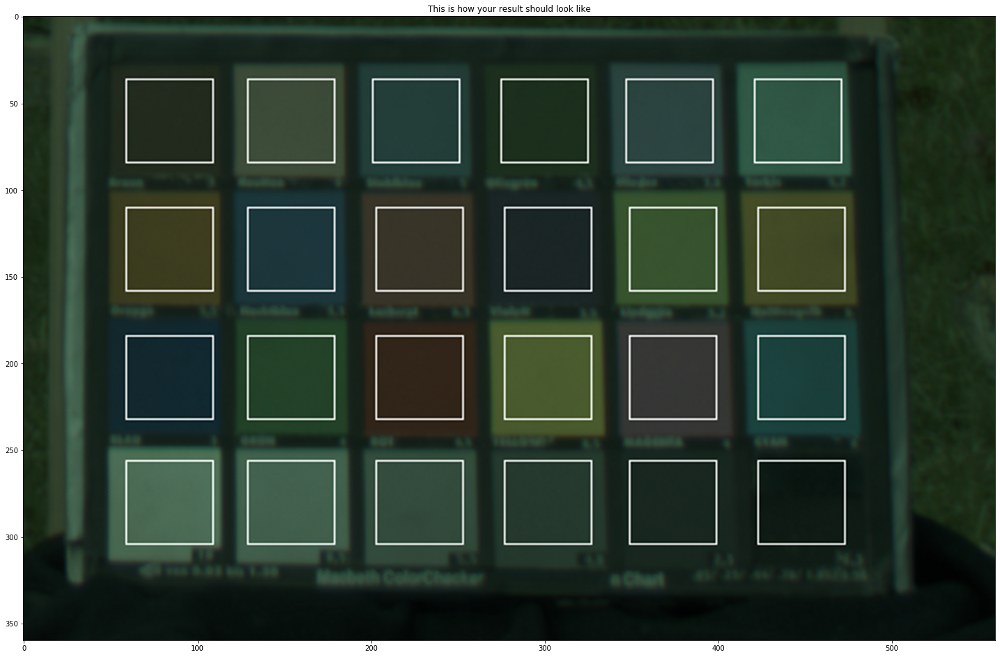

In [7]:
# To remove the green cast from the image one could scale all three color channels so that the white patch of the color checker ( 19th Patch ) results in the target values from Babelcolor converted to linear. Use the supplied function Exercise_04_getCheckerValuesFromHausImage.m to extract the color checker values from your image. 

# Exttract the actual values from the color checker
cc_vals = getCheckerValuesFromHausImage(hdrImg)

plt.figure()
plt.imshow( plt.imread('additional/cc_select.png'), interpolation = 'catrom' );
plt.title('This is how your result should look like')

cc_vals.shape


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'This is how your result should look like')

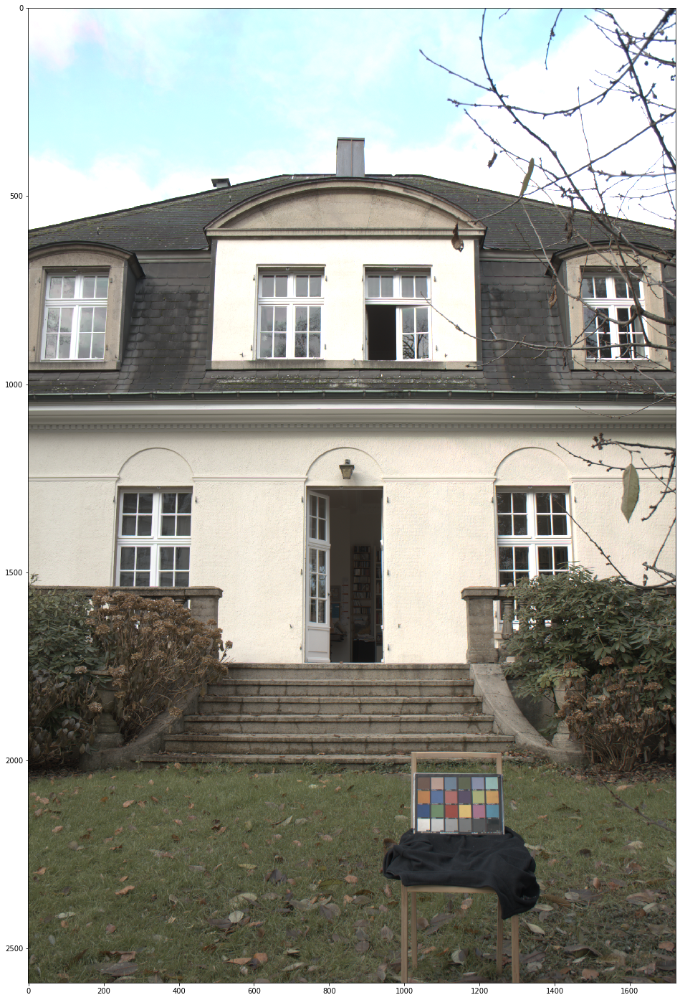

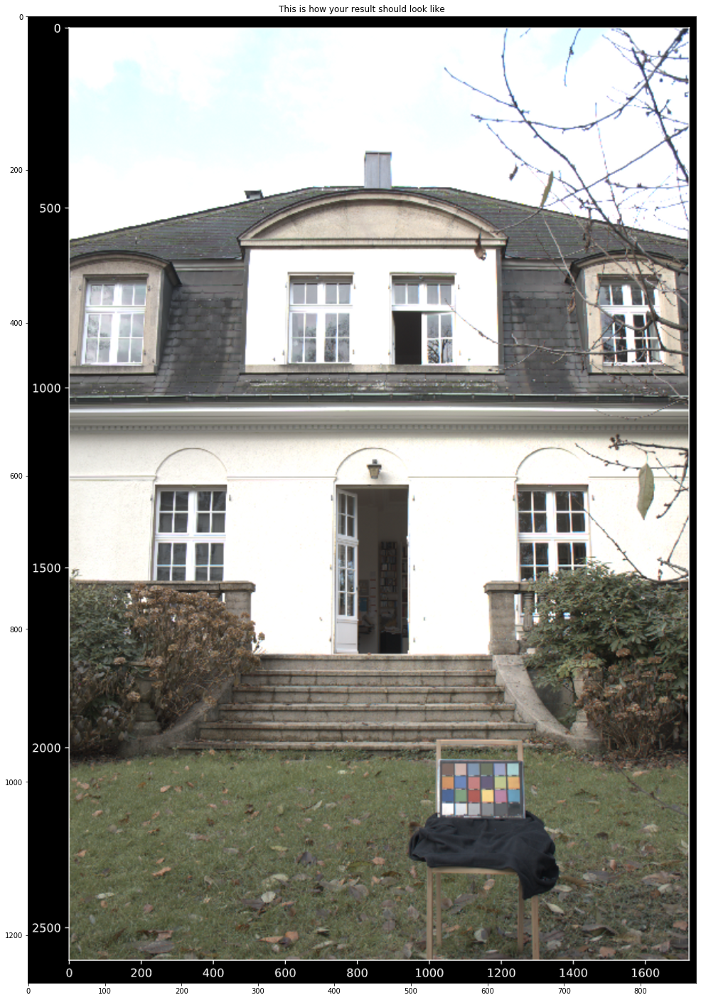

In [8]:
# Now Scale the three color channels accordingly and display the image. 

# * Hint 1: It is common to have diffuse white at 1.0 in linear light images. One stop below white is at 0.5, two stops below white at 0.25 and typical Caucasian skin tones at 0.18. Specular highlights and light sources can be way above 1.0.

imgCCbyScaling = np.zeros(hdrImg.shape)

for i in range(3):
    imgCCbyScaling[:,:,i] = hdrImg[:,:,i] * (cc_ref[21,i]/ cc_vals[21,i])
    # Your code here

plt.imshow( linear2srgb( imgCCbyScaling ) )

plt.figure()
plt.imshow( plt.imread('additional/Result_RGB_Scaling.png'), interpolation = 'catrom' );
plt.title('This is how your result should look like')


# You have solved one problem, but which problem persists?
# In den ungesättigten Flächen funktioniert der Weißabgleich, der Grünschleier ist gelöst. Sehr farbigen Flächen erscheinen ungesättigt.
# Auch die farbigen Artefakte im Himmel bestehen weiterhin.

### 3.2.2 Direct inverse

CheckerBoard (Ergebnis): 
[[0.42817808 0.03184081 0.04127557]
 [0.06491755 0.29999672 0.06555101]
 [0.02308553 0.04946888 0.29213838]]
Inverse Matrix (Multiplikation mit Quelle): 
[[23.96563067 -3.52957549 -1.03504137]
 [-5.69558939 11.54503618 -5.7375741 ]
 [ 0.42930386 -5.42913299 20.11111051]]
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'This is how your result should look like')

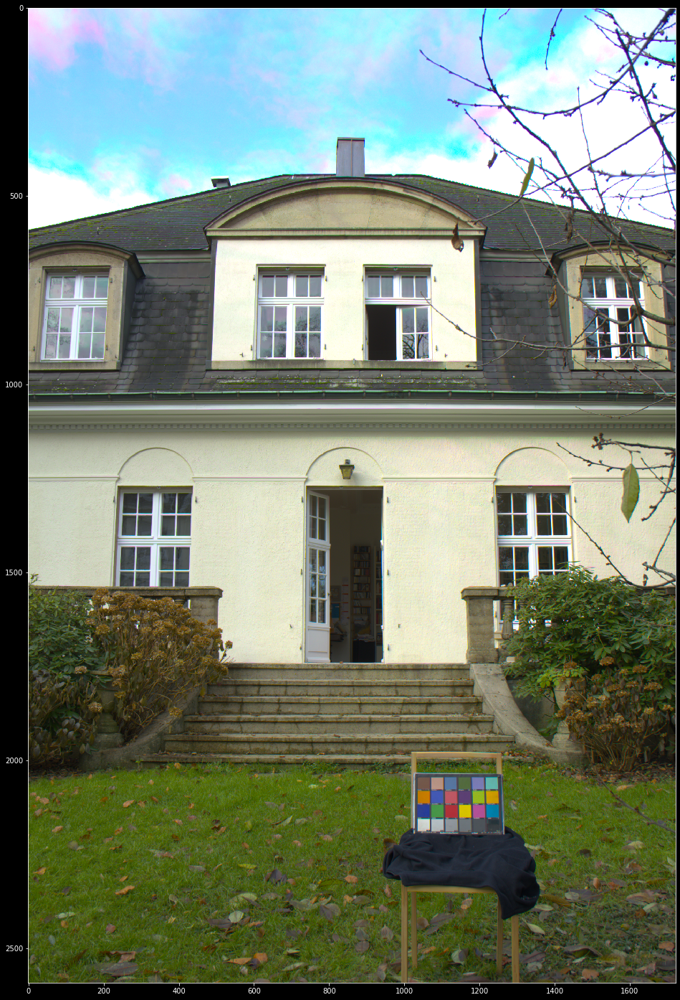

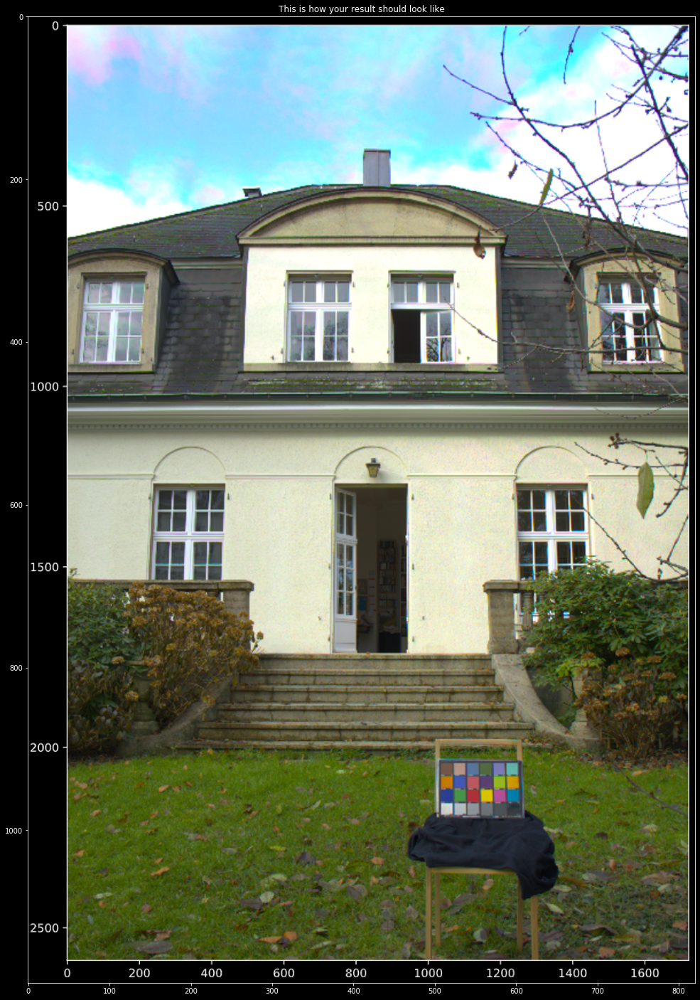

In [26]:
# The second approach to camera characterization that you learned in the lecture is the direct inverse. Calculate the matrix that results in the correct color values for the red, green and blue patch.
from numpy.linalg import inv, pinv
# Get the source values again
cc_vals = getCheckerValuesFromHausImage(hdrImg, no_checker=True)

# Calculate the direct inverse. Yes, this is only one line, but it may take an hour of remebering matrix algebra
#direct_inverse = # Your code here. Direct inverse shoud be a 3*3 matrix.

a = np.zeros((3,3))
b = np.zeros((3,3))
c = np.zeros((3,3))

'''a[0,:]= cc_vals[14]
a[1,:]= cc_vals[13]
a[2,:]= cc_vals[12]

print("gemessen im Bild: \n" + str(a))

b[0,:]= cc_ref[14]
b[1,:]= cc_ref[13]
b[2,:]= cc_ref[12]

print("Referenzwerte (Ziel): \n" + str(b))'''
for i in range(3):
    a[i] = cc_vals[14-i]
    b[i] = cc_ref[14-i]

#a = (np.concatenate(cc_vals[12:15]) * np.concatenate(cc_ref[12:15]))

direct_inverse = np.matmul( inv(a), b ) 

#direct_inverse = np.zeros((3,3))
#direct_inverse[:,0]= np.ones((3))
#print("inverse Matrix: \n" + str(direct_inverse))
img_di = applyColorMatrix( hdrImg, direct_inverse )
cc_Img = getCheckerValuesFromHausImage(img_di, no_checker=True)

c[0,:]= cc_Img[14]
c[1,:]= cc_Img[13]
c[2,:]= cc_Img[12]

print("CheckerBoard (Ergebnis): \n" + str(c))
print("Inverse Matrix (Multiplikation mit Quelle): \n" + str(direct_inverse))

plt.imshow( linear2srgb( img_di ) )

plt.figure()
plt.imshow( plt.imread('additional/Result_Direct_Inverse.png'), interpolation = 'catrom' );
#plt.imshow( plt.imread('additional/Result_Direct_Inverse.png'), interpolation = 'catrom' );
plt.title('This is how your result should look like')

# What do you like about this method? What could be improved?

In [27]:
# verifizieren:
cc_vals = getCheckerValuesFromHausImage(img_di, no_checker=True)
print(cc_vals[12:15])
print(cc_ref[12:15])

[[0.02308553 0.04946888 0.29213838]
 [0.06491755 0.29999672 0.06555101]
 [0.42817808 0.03184081 0.04127557]]
[[0.02315337 0.04970657 0.29177065]
 [0.06480327 0.30054379 0.06480327]
 [0.4286905  0.03189603 0.0409152 ]]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'This is how your result should look like')

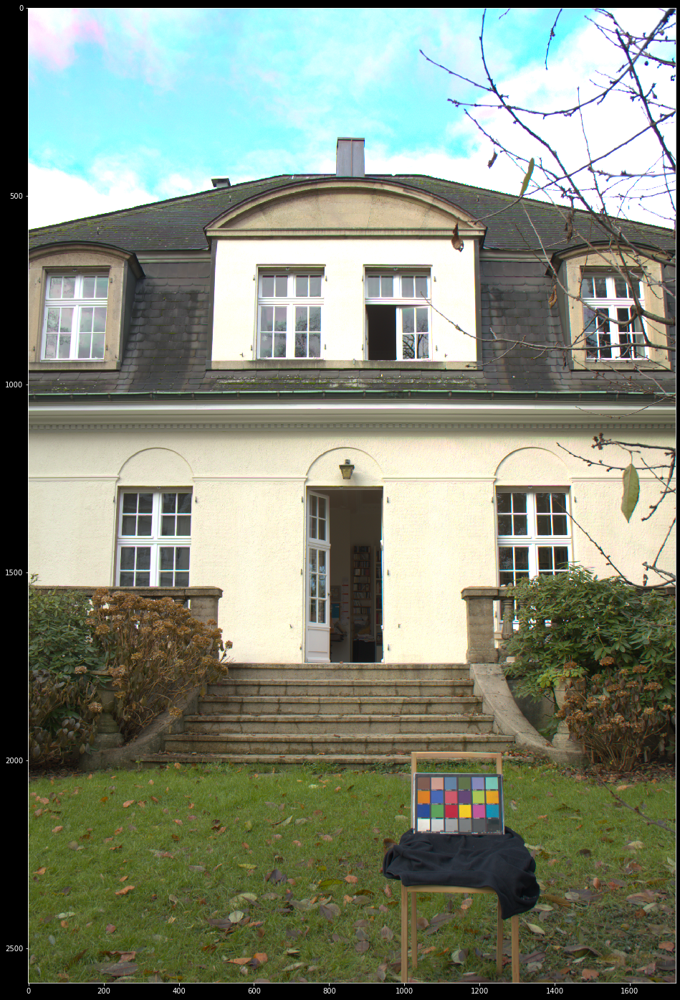

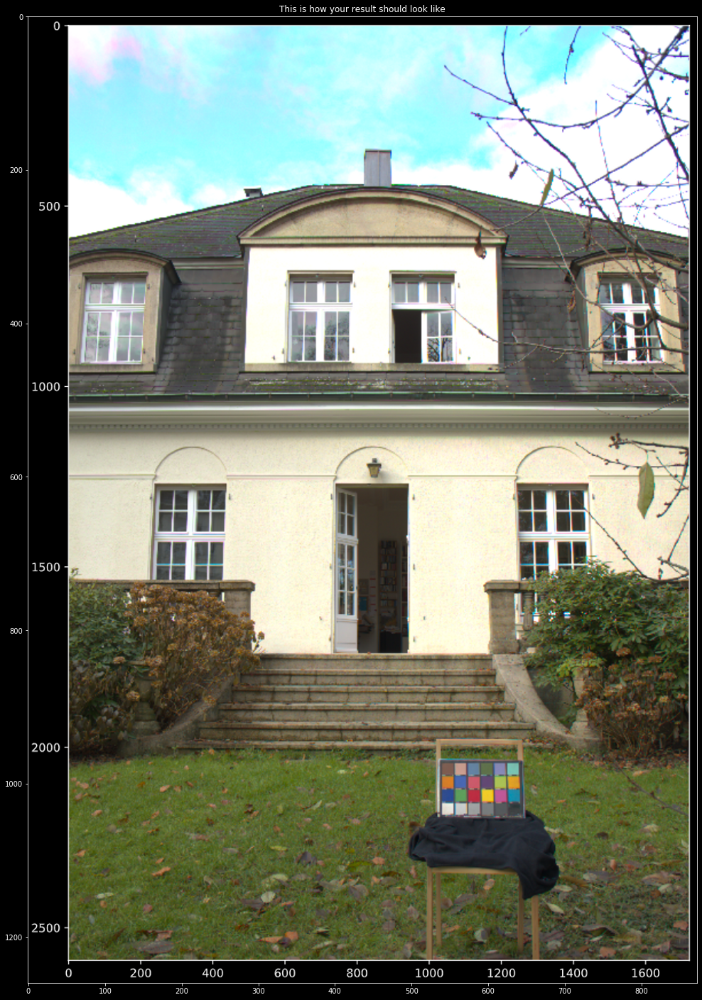

In [29]:
# Now calculate the pseudoinverse using all 24 patches in linear RGB domain. If you are unsure how to find the matrix that minimizes the squared error for all 24 patches search for ‘linear least squares’ or ‘normal equation’. You may also want to watch this graphical explanation of the least squares pseudo inverse: https://www.youtube.com/watch?v=Z0wELiinNVQ&nohtml5=False. (0:00 – 8:40)

# Apply the matrix you calculated to your reconstructed image. 

cc_vals = getCheckerValuesFromHausImage(hdrImg, no_checker=True)

start = np.ones((3,3))
q = np.zeros((24,3))
z = np.zeros((24,3))
for i in range(24):
    q[i] = cc_vals[i]
    z[i] = cc_ref[i]

def lsColors(x):
    return sum(pow(q * x - z))
                
# "optimize.fmin" is quite slow

#pseudo_inverse = optimize.fmin( func=lsColors, x0=start, disp=False)[0]

# Your code here. Direct inverse shoud be a 3*3 matrix.
# aus Fragentermin:
pseudo_inverse = np.linalg.lstsq(cc_vals, cc_ref)[0]

#print(pseudo_inverse)

img_pi = applyColorMatrix( hdrImg, pseudo_inverse )

plt.imshow(linear2srgb(img_pi))

plt.figure()
plt.imshow( plt.imread('additional/Result_Pseudo_Inverse.png'), interpolation = 'catrom' );
plt.title('This is how your result should look like')

# Compare the colors to both methods before. Which method do you prefer and why?
#
#

# In which domain would an actual color scientist minimize the squared error for the pseudo inverse matrix? What Python function would you use for this?
#
#
#

In [ ]:
# Save for later use!
np.save('hdr_image_pinv', img_pi)